### Comparing the different sized models performance on out of domain data

In [1]:
# Imports
from evaluation.evaluate_yolo_tracker import evaluate_sequence, VAL_SEQUENCES
import matplotlib.pyplot as plt
from ultralytics import YOLO
import pandas as pd
import numpy as np
import cv2
import os

Error importing BURST due to missing underlying dependency: No module named 'pycocotools'


In [ ]:
# Not used so far since it works of tracking outputs not detections

# Frame plotting functions
def draw_bbox(img, gt_bbox, pred_bbox, pred_conf, track_ids):
  color1 = (0, 255, 0)
  color2 = (0, 0, 255)

  for bbox in gt_bbox:
    bbox = np.array(bbox).astype(int)
    pt1, pt2 = (bbox[0], bbox[1]), (bbox[2], bbox[3])
    img = cv2.rectangle(img, pt1, pt2, color1, int(max(img.shape[:2]) / 200))

  for i, pair in enumerate(zip(pred_bbox, pred_conf)):
    bbox, conf = pair
    bbox = np.array(bbox).astype(int)
    pt1, pt2 = (bbox[0], bbox[1]), (bbox[2], bbox[3])
    img = cv2.rectangle(img, pt1, pt2, color2, int(max(img.shape[:2]) / 200))
    text = f'Pred: {conf:.2f}'
    if len(track_ids) > 0:
      text += f' (ID: {track_ids[i]})'
    img = cv2.putText(img, text, (bbox[0], bbox[1] - 10), cv2.FONT_HERSHEY_SIMPLEX, 1, color2, 1, cv2.LINE_AA)

  # Add legend for color
  img = cv2.putText(img, 'Ground Truth', (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, color1, 2, cv2.LINE_AA)
  img = cv2.putText(img, 'Predictions', (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 1, color2, 2, cv2.LINE_AA)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  plt.imshow(img_rgb)


def plot_frame(frame_path, frame_num, aligned_annotations):
  """
  Plots the ground truth and predicted bounding boxes of a given frame.
  """
  gt_bbox = aligned_annotations['gt_bbox_xyxys'][frame_num]
  pred_bbox = aligned_annotations['pred_bbox_xyxys'][frame_num]
  pred_conf = aligned_annotations['pred_confidences'][frame_num]
  track_ids = aligned_annotations['pred_track_ids']
  if len(track_ids) > 0:
    track_ids = track_ids[frame_num]

  # Convert frame number to timestamp (in milliseconds)
  timestamp = (frame_num / 10) * 1000  # frame_num / fps * 1000

  # Read the frame
  frame = cv2.imread(frame_path)

  # Plot the ground truth and predicted bounding boxes
  draw_bbox(frame, gt_bbox, pred_bbox, pred_conf, track_ids)

In [13]:
def load_model(model_version):
    """
    takes a model version and loads the YOLO model
    """
    project = '/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/'
    model_folder_path = os.path.join(project, 'models', model_version)
    model_path = os.path.join(model_folder_path, 'weights/best.pt')
    
    return YOLO(model_path)

In [7]:
# First test with some of the validation frames. Ie plotting the ground truth and predicted bounding boxes of a given frame.

# Load the YOLOv8 model
model_version = 'p3v6_n2'
# model_version = 'p3v6_v8s_1000e2'

model = load_model(model_version)

In [32]:
# load the images
val_sequence = 'easy1'
dataset = f'/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Videos/{val_sequence}/frames'

annot_frame_to_inspect = 150

# total videos frames over total annotation frames
fps_ratio = 282 / 199
video_frame_to_inspect = int(annot_frame_to_inspect * fps_ratio)

# add leading zeros to the frame number
frame_name = f'{annot_frame_to_inspect:05d}.jpg'
# frame_to_inspect = '0001.jpg' 

frame_path = os.path.join(dataset, frame_name)

frames = [frame_path]

In [33]:
# Inference
results = model(frames)


0: 384x640 1 shark, 6.1ms
Speed: 4.5ms preprocess, 6.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


In [34]:
print(results[0].save())  # save the results to 'runs/detect/predict'

results_00150.jpg


In [13]:
# Load production SharkTrack
model = YOLO("/vol/biomedic3/bglocker/ugproj/tk1420/sharktrack/models/sharktrack.pt")
IoU = 0.5
conf_thresh = 0.5

In [8]:
# Now try it with the v8s model (with the code below)
model = YOLO("/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/models/p3v6_v8s_1000e2/weights/best.pt")

In [ ]:
# Now with the v11s model
model = YOLO("/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/models/p3v6_11s_1000/weights/best.pt")

In [ ]:
# Bulk it on st frames from North Sea

site = 'BE-C09_240_BRUV5'
# image_dir = '/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Videos/North-Sea/'
image_dir = os.path.join('/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Videos/North-Sea/', site)
image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]

# Create a list of image paths
image_paths = [os.path.join(image_dir, f) for f in image_files]

# Inference
for image_path in image_paths:
    results = model.predict(image_path, save=True, save_txt=False, project=f'runs/yolov8n-prod/{site}', name='North-Sea')

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea16/22-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea16/22-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea16/22-elasmobranch.jpg


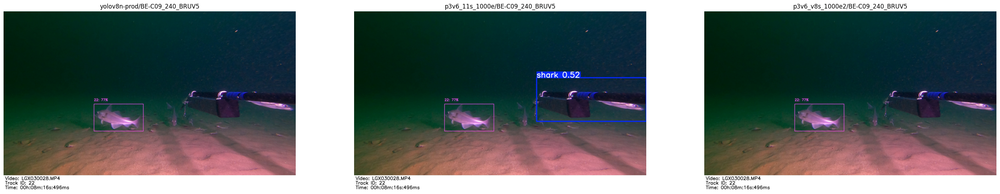

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea24/1-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea24/1-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea24/1-elasmobranch.jpg


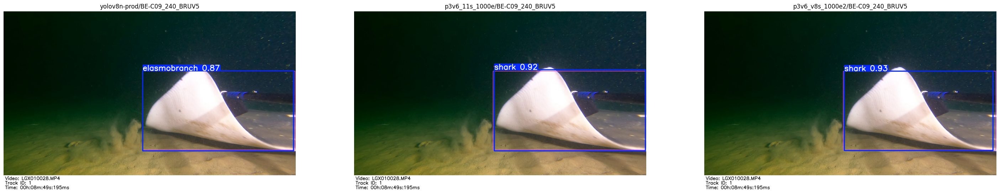

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea/19-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea/19-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea/19-elasmobranch.jpg


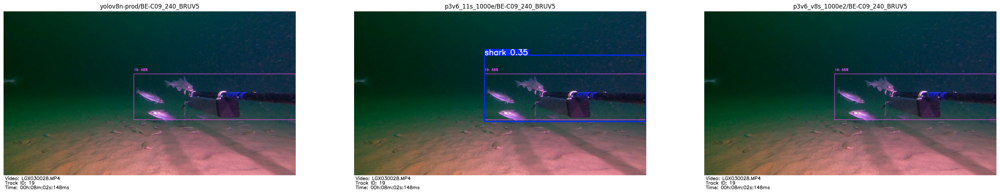

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea7/18-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea7/18-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea7/18-elasmobranch.jpg


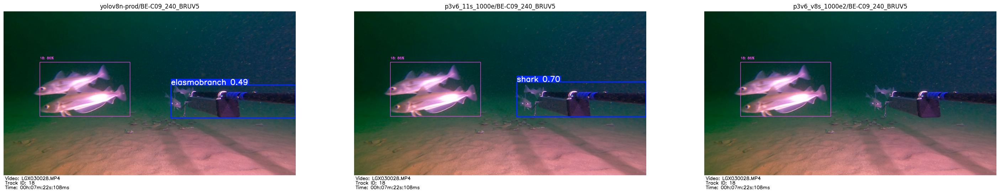

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea40/17-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea40/17-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea40/17-elasmobranch.jpg


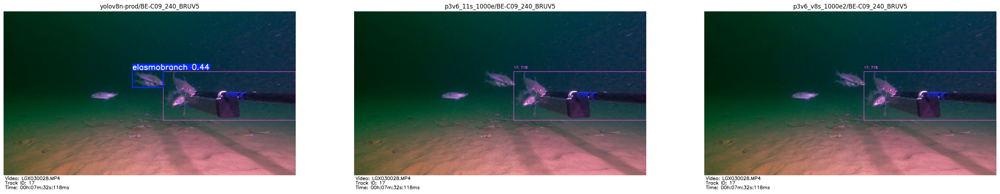

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea37/16-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea37/16-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea37/16-elasmobranch.jpg


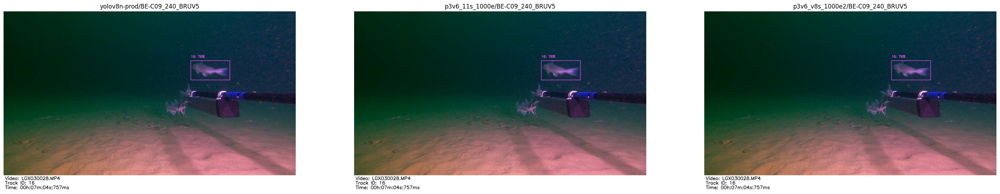

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea30/13-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea30/13-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea30/13-elasmobranch.jpg


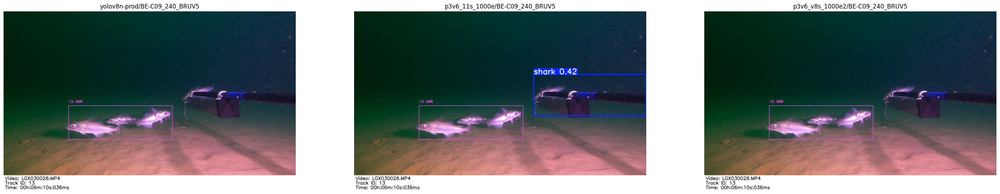

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea29/0-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea29/0-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea29/0-elasmobranch.jpg


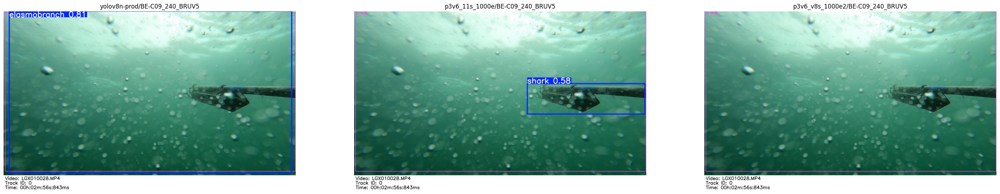

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea23/35-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea23/35-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea23/35-elasmobranch.jpg


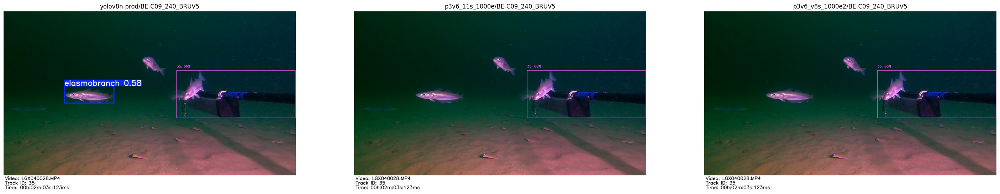

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea11/25-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea11/25-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea11/25-elasmobranch.jpg


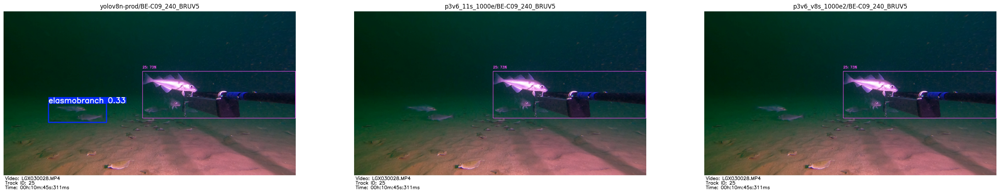

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea15/3-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea15/3-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea15/3-elasmobranch.jpg


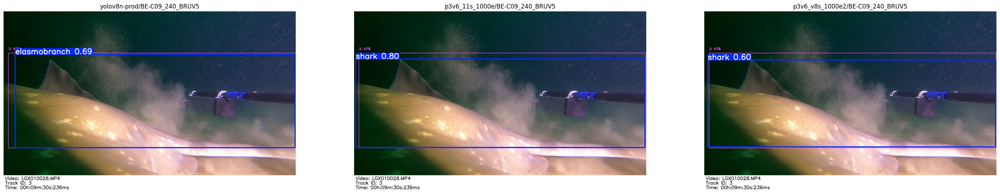

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea27/42-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea27/42-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea27/42-elasmobranch.jpg


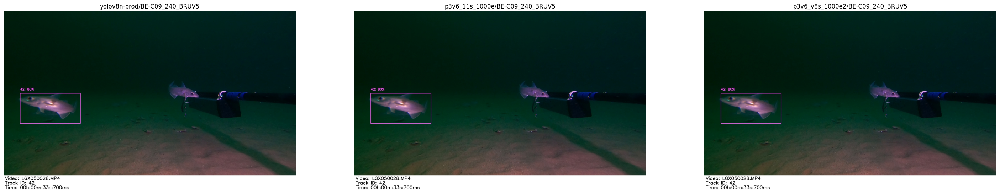

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea4/32-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea4/32-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea4/32-elasmobranch.jpg


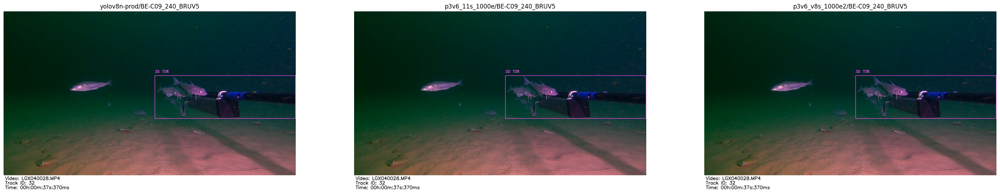

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea34/11-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea34/11-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea34/11-elasmobranch.jpg


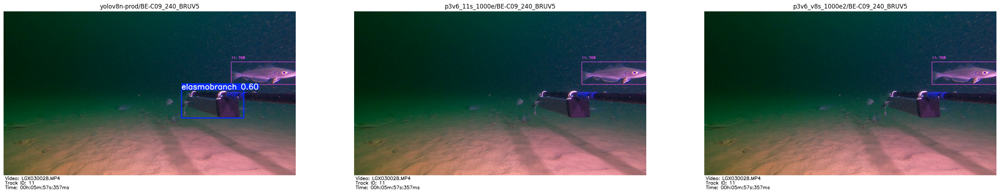

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea43/15-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea43/15-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea43/15-elasmobranch.jpg


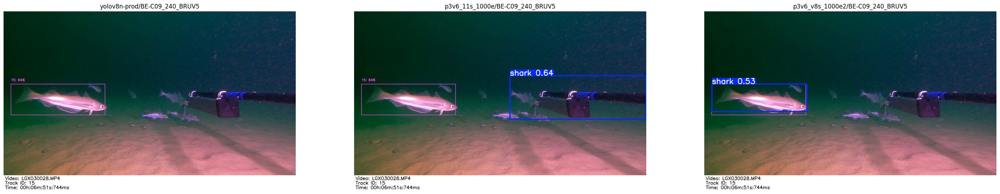

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea39/8-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea39/8-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea39/8-elasmobranch.jpg


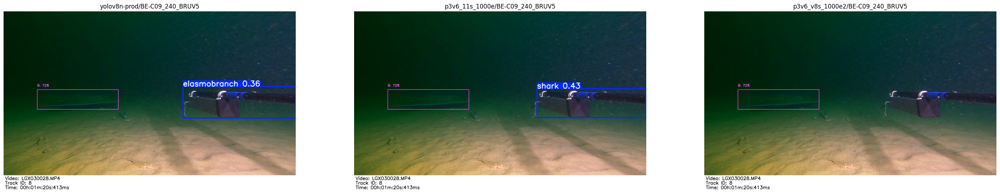

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea33/39-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea33/39-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea33/39-elasmobranch.jpg


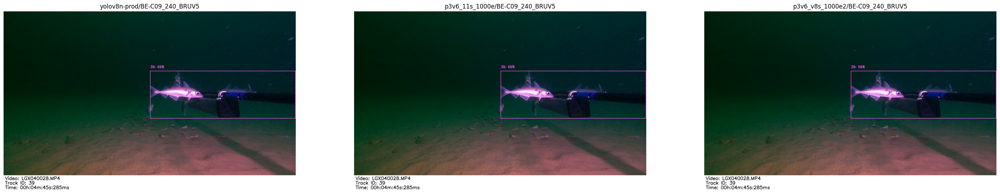

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea3/27-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea3/27-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea3/27-elasmobranch.jpg


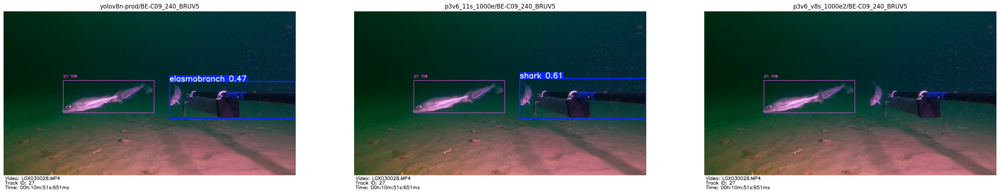

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea9/30-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea9/30-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea9/30-elasmobranch.jpg


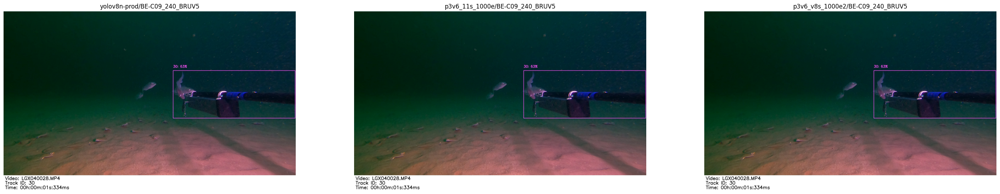

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea20/40-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea20/40-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea20/40-elasmobranch.jpg


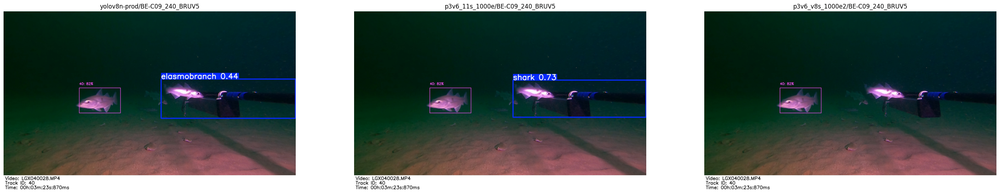

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea12/31-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea12/31-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea12/31-elasmobranch.jpg


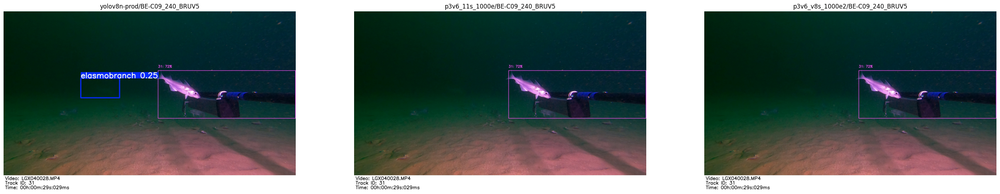

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea18/37-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea18/37-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea18/37-elasmobranch.jpg


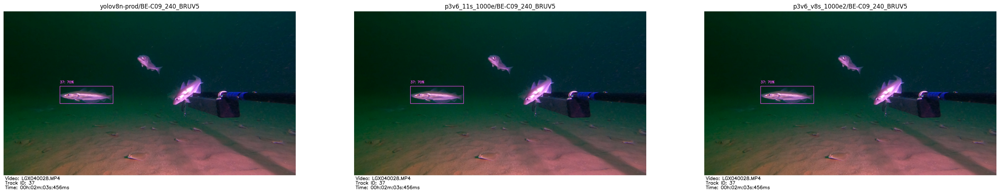

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea22/36-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea22/36-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea22/36-elasmobranch.jpg


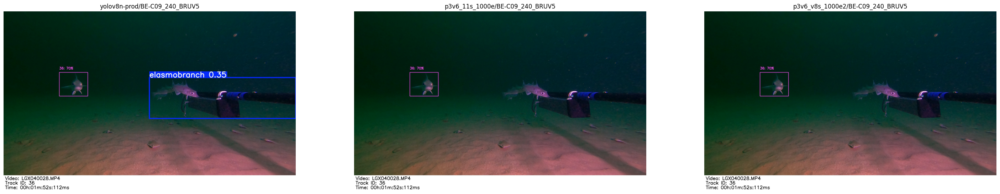

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea28/21-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea28/21-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea28/21-elasmobranch.jpg


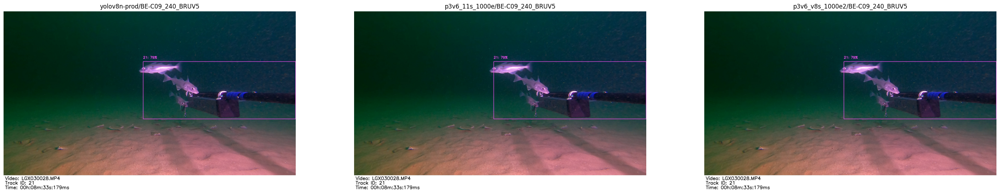

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea10/4-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea10/4-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea10/4-elasmobranch.jpg


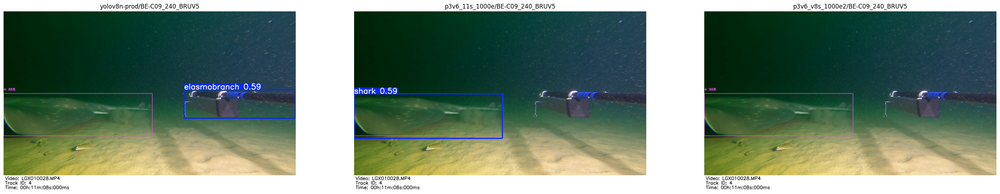

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea31/38-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea31/38-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea31/38-elasmobranch.jpg


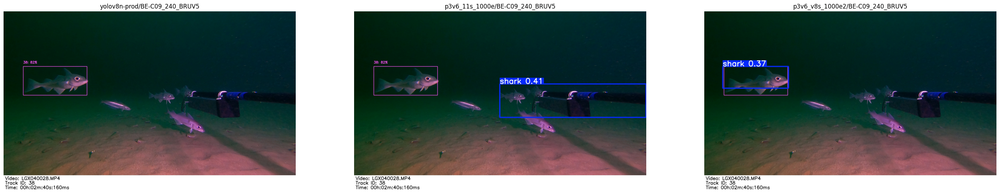

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea6/7-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea6/7-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea6/7-elasmobranch.jpg


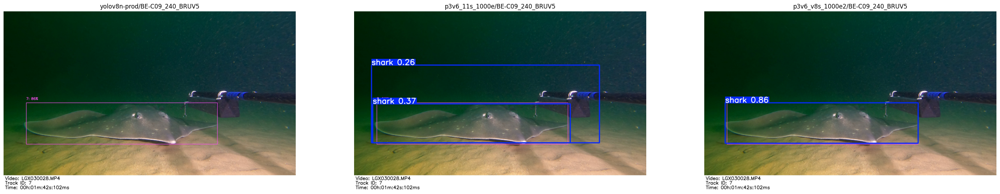

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea36/28-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea36/28-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea36/28-elasmobranch.jpg


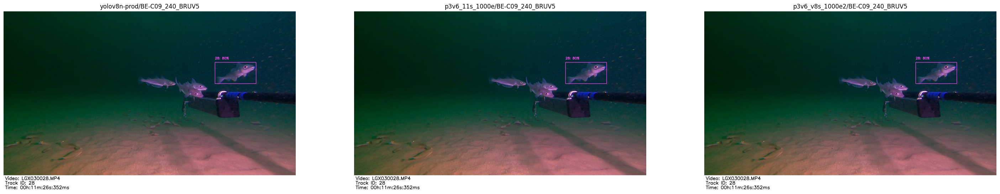

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea41/29-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea41/29-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea41/29-elasmobranch.jpg


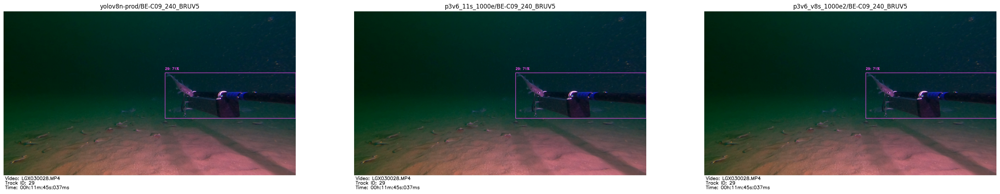

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea17/41-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea17/41-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea17/41-elasmobranch.jpg


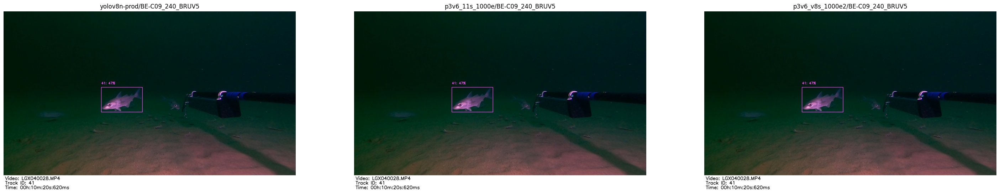

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea25/20-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea25/20-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea25/20-elasmobranch.jpg


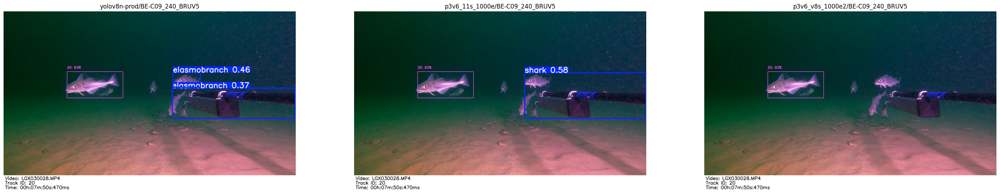

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea21/2-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea21/2-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea21/2-elasmobranch.jpg


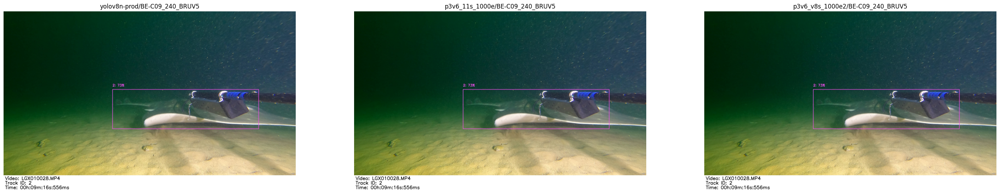

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea19/23-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea19/23-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea19/23-elasmobranch.jpg


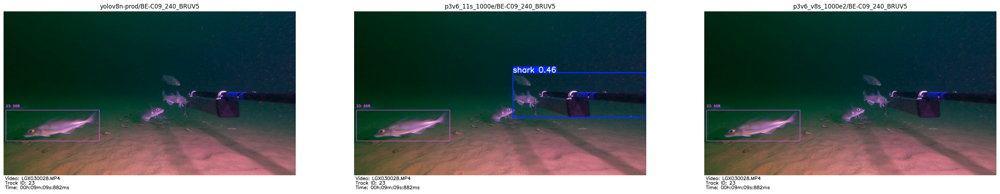

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea13/24-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea13/24-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea13/24-elasmobranch.jpg


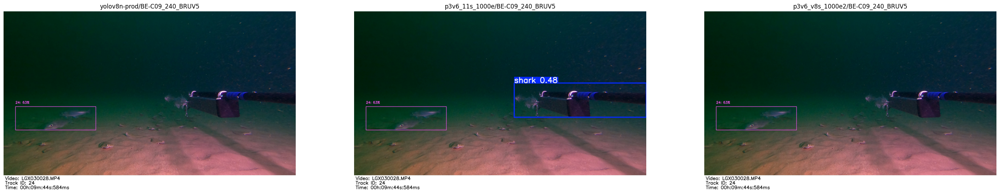

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea32/12-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea32/12-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea32/12-elasmobranch.jpg


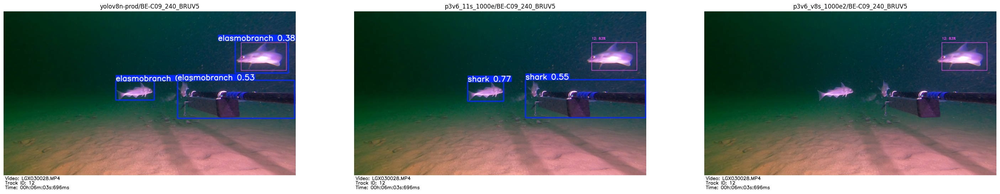

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea38/9-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea38/9-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea38/9-elasmobranch.jpg


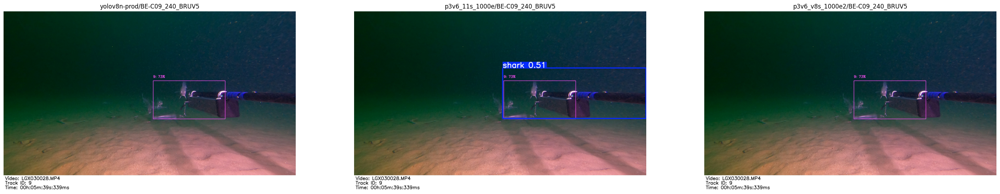

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea8/33-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea8/33-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea8/33-elasmobranch.jpg


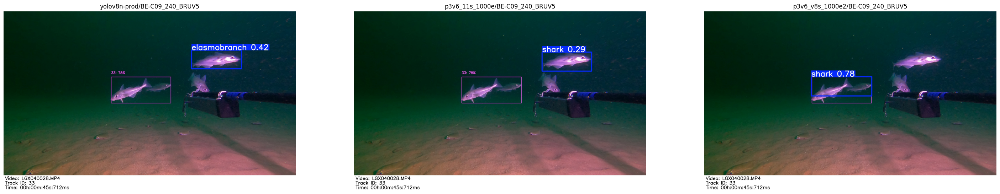

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea2/6-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea2/6-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea2/6-elasmobranch.jpg


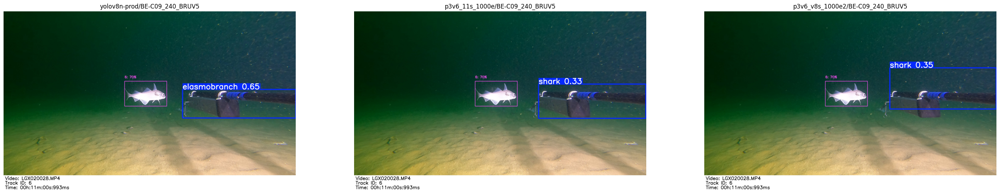

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea5/26-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea5/26-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea5/26-elasmobranch.jpg


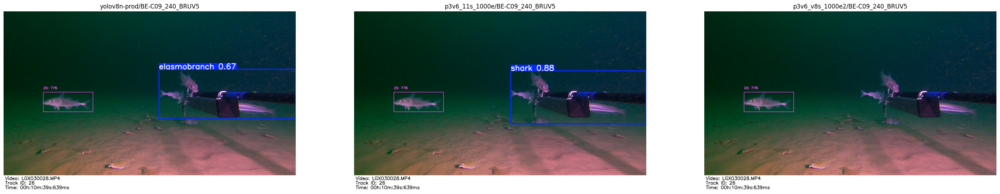

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea42/14-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea42/14-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea42/14-elasmobranch.jpg


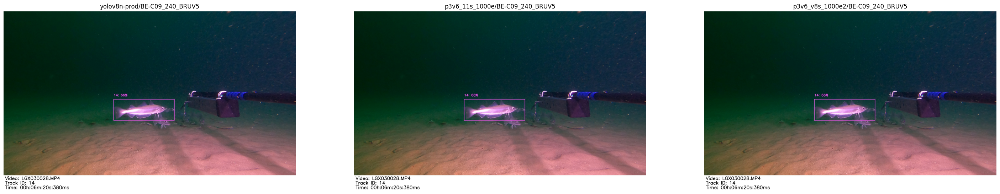

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea35/10-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea35/10-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea35/10-elasmobranch.jpg


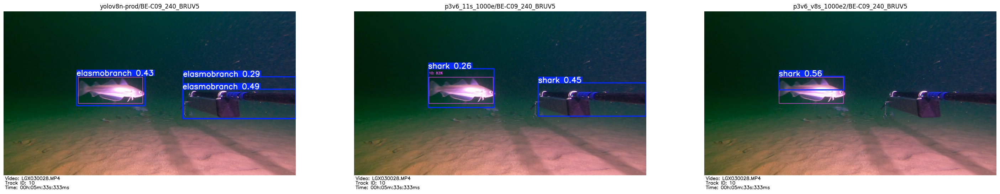

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea14/5-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea14/5-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea14/5-elasmobranch.jpg


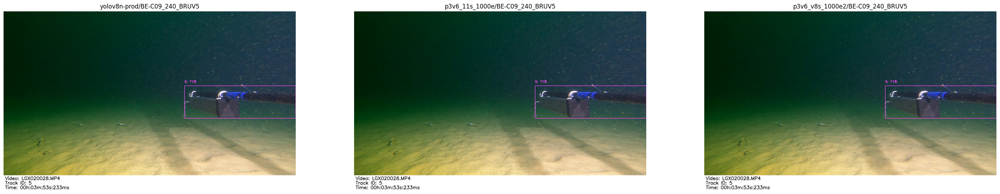

/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/yolov8n-prod/BE-C09_240_BRUV5/North-Sea26/34-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea26/34-elasmobranch.jpg
/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/p3v6_v8s_1000e2/BE-C09_240_BRUV5/North-Sea26/34-elasmobranch.jpg


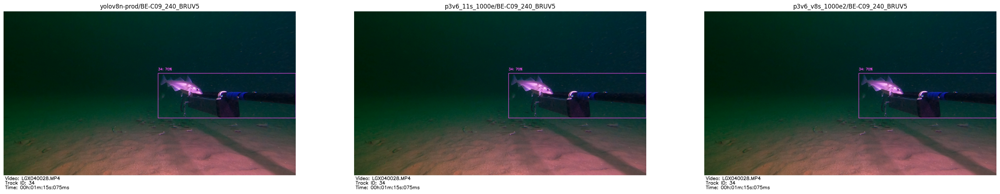

In [9]:
# Visualize the results
outputs_dir = '/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/'

model_dirs = [d for d in os.listdir(outputs_dir) if d != 'detect']
# ie ['yolov8n-prod', 'yolov8s'] etc

model_site_dirs = [os.path.join(model_dir, site) for model_dir in model_dirs]
# ie ['yolov8n-prod/BE-C09_240_BRUV5', 'yolov8s/BE-C09_240_BRUV5'] etc

for model_site_dir in model_site_dirs:
    if not os.path.exists(os.path.join(outputs_dir, model_site_dir)):
        print(f"Directory does not exist: {model_site_dir}")

# structure of the output directory /runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea[1...]/0001.jpg
path_suffixes = os.listdir(os.path.join(outputs_dir, model_site_dirs[0]))

# Visualise each of the corresponding images side by side for each model
for num_pics, subdir in enumerate(path_suffixes):
    model_predictions = []
    for model in model_site_dirs:
        
        # eg /vol/.../runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea2
        image_path = os.path.join(outputs_dir, model, subdir)
        # ie /vol/.../runs/p3v6_11s_1000e/BE-C09_240_BRUV5/North-Sea2/0001.jpg
        image_path = os.path.join(image_path, os.listdir(image_path)[0])
        print(image_path)
        if not os.path.exists(image_path):
            print(f"Image not found: {image_path}")
        
        model_predictions.append((model, image_path))
    # plot the model predictions side by side
    # Set the figure size for the entire plot
    plt.figure(figsize=(12 * len(model_predictions), 10))
    
    for i, (model_name, image_path) in enumerate(model_predictions):
        img = cv2.imread(image_path)
        plt.subplot(1, len(model_predictions), i + 1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f'{model_name}')
        plt.axis('off')
    plt.show()
    


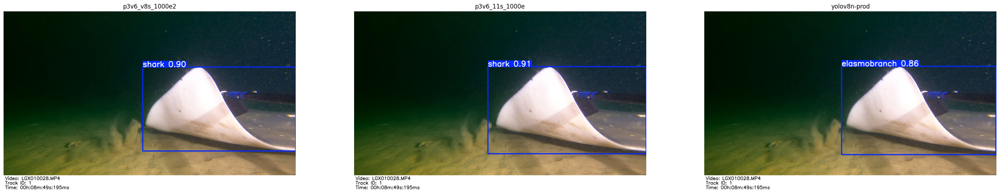

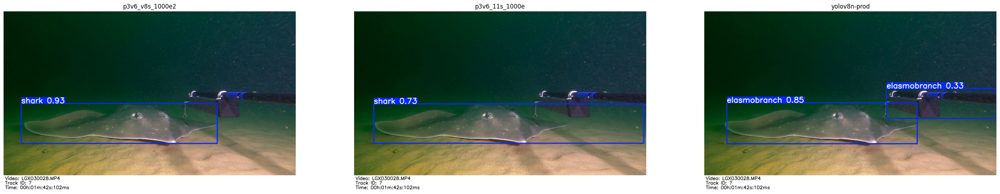

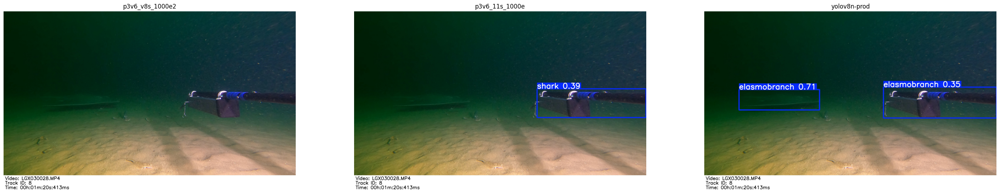

In [19]:
image_paths = [
    "/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Videos/North-Sea/extra/1-elasmobranch_no_bbpsd.jpg",
    "/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Videos/North-Sea/extra/7-elasmobranch_no_bb.jpg",
    "/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Videos/North-Sea/extra/8-elasmobranch_no_bb.psd.jpg"
]

# prod model
# model = YOLO("/vol/biomedic3/bglocker/ugproj/tk1420/sharktrack/models/sharktrack.pt")
# model.predict(image_paths, save=True, save_txt=False, project='runs/yolov8n-prod/North-Sea-no-bb', name='North-Sea')

# model_names = ['p3v6_v8s_1000e2', 'p3v6_11s_1000e']

# for model_name in model_names:
#     # Load the YOLOv8 model
#     model = load_model(model_name)
    
#     # Inference
#     results = model.predict(image_paths, save=True, save_txt=False, project=f'runs/{model_name}/North-sea-no-bb', name='North-Sea')
    

# model = YOLO("/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/models/p3v6_v8s_1000e2/weights/best.pt")
# results = model.predict(image_path, save=True, save_txt=False, project='runs/yolov8n-prod', name='North-Sea-misc')


# Display the results side by side per image:
model_run_path = '/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Dev/runs/'
model_names = ['p3v6_v8s_1000e2', 'p3v6_11s_1000e', 'yolov8n-prod']
image_dirs = [os.path.join(model_run_path, model_name, 'North-sea-no-bb/North-Sea') for model_name in model_names]

image_names = ['1-elasmobranch_no_bbpsd.jpg', '7-elasmobranch_no_bb.jpg', '8-elasmobranch_no_bb.psd.jpg']

for image_name in image_names:
    image_paths = [os.path.join(image_dir, image_name) for image_dir in image_dirs]
    
    # Set the figure size for the entire plot
    plt.figure(figsize=(12 * len(image_paths), 10))
    
    for i, image_path in enumerate(image_paths):
        img = cv2.imread(image_path)
        plt.subplot(1, len(image_paths), i + 1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f'{model_names[i]}')
        plt.axis('off')
    plt.show()

In [2]:
image_path = "/vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Videos/North-Sea/extra/8-emulate-src-chatgpt.png"
# infer with prod

model = YOLO("/vol/biomedic3/bglocker/ugproj/tk1420/sharktrack/models/sharktrack.pt")

results = model.predict(image_path, save=True, save_txt=False, project='runs/yolov8n-prod', name='North-Sea-misc')
# Display the results


image 1/1 /vol/biomedic3/bglocker/ugproj/tk1420/SharkTrack-Videos/North-Sea/extra/8-emulate-src-chatgpt.png: 448x640 (no detections), 25.6ms
Speed: 4.8ms preprocess, 25.6ms inference, 15.0ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/yolov8n-prod/North-Sea-misc2
